# FRANKFURTER API - Currency Time Series Prediction

# Notebook 3 : Modelo

Documentación: https://www.frankfurter.app/docs/

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import time
import datetime

import pickle

import requests

import kaleido

from pprint import pprint
from IPython.display import HTML
from PIL import Image

import warnings

In [2]:
warnings.filterwarnings('ignore')

Cargamos el último DataFrame que se haya guardado.

In [3]:
historical_complete = pd.read_parquet("Data/historical.parquet")

In [4]:
historical_complete

,AUD,BGN,BRL,CAD,CHF,CNY,CYP,CZK,DKK,EEK,...,SGD,SIT,SKK,THB,TRL,TRY,USD,ZAR,EUR,Dates
0,1.9100,NaN,NaN,1.8004,1.6168,NaN,0.58231,35.107,7.4501,15.6466,...,1.9554,189.04,42.991,NaN,372274.0,NaN,1.1789,6.9358,1,1999-01-04
1,1.8944,NaN,NaN,1.7965,1.6123,NaN,0.58230,34.917,7.4495,15.6466,...,1.9655,188.78,42.848,NaN,372816.0,NaN,1.1790,6.7975,1,1999-01-05
2,1.8820,NaN,NaN,1.7711,1.6116,NaN,0.58200,34.850,7.4452,15.6466,...,1.9699,188.70,42.778,NaN,372188.0,NaN,1.1743,6.7307,1,1999-01-06
3,1.8474,NaN,NaN,1.7602,1.6165,NaN,0.58187,34.886,7.4431,15.6466,...,1.9436,188.80,42.765,NaN,370147.0,NaN,1.1632,6.8283,1,1999-01-07
4,1.8406,NaN,NaN,1.7643,1.6138,NaN,0.58187,34.938,7.4433,15.6466,...,1.9537,188.84,42.560,NaN,371830.0,NaN,1.1659,6.7855,1,1999-01-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9030,1.6544,1.9558,5.2516,1.4311,0.9676,7.7728,NaN,24.377,7.4571,NaN,...,1.4524,NaN,NaN,38.396,NaN,28.931,1.0633,19.9410,1,2023-09-25
9031,1.6539,1.9558,5.2721,1.4318,0.9675,7.7517,NaN,24.411,7.4575,NaN,...,1.4500,NaN,NaN,38.549,NaN,28.919,1.0605,20.1390,1,2023-09-26
9032,1.6541,1.9558,5.2716,1.4255,0.9680,7.7031,NaN,24.470,7.4566,NaN,...,1.4449,NaN,NaN,38.541,NaN,28.767,1.0536,20.2220,1,2023-09-27
9033,1.6483,1.9558,5.3115,1.4206,0.9678,7.6986,NaN,24.378,7.4558,NaN,...,1.4431,NaN,NaN,38.657,NaN,28.895,1.0539,20.1700,1,2023-09-28


Visualizamos todas las divisas en un gráfico interactivo.

In [5]:
fig_line = px.line(data_frame = historical_complete, x = "Dates", y = historical_complete.columns[:-2].dropna(),
              title = "Línea Temporal de todas las Divisas con respecto a 1€", 
              width = 1000, height = 600, template = "seaborn")

fig_line.update_xaxes(title_text="Fechas")
fig_line.update_yaxes(title_text="Equivalencia")

fig_line.show()

fig_line.write_html("Data/grafico_temporal_todas_divisas.html")

Observamos que la Lira Turca (TRL) es la divisa con el cambio más alto, por mucho, desde que se tiene registro.

Comprobamos cuáles son las divisas que no contienen "NaN".

In [6]:
nan_currencies = dict()

for col in historical_complete.columns[:-2]:
    
    nan_currencies[col] = historical_complete[col].isna().unique().tolist()
    
print(nan_currencies)

{'AUD': [False], 'BGN': [True, False], 'BRL': [True, False], 'CAD': [False], 'CHF': [False], 'CNY': [True, False], 'CYP': [False, True], 'CZK': [False], 'DKK': [False], 'EEK': [False, True], 'GBP': [False], 'HKD': [False], 'HRK': [True, False], 'HUF': [False], 'IDR': [True, False], 'ILS': [True, False], 'INR': [True, False], 'ISK': [False, True], 'JPY': [False], 'KRW': [False], 'LTL': [False, True], 'LVL': [False, True], 'MTL': [False, True], 'MXN': [True, False], 'MYR': [True, False], 'NOK': [False], 'NZD': [False], 'PHP': [True, False], 'PLN': [False], 'ROL': [False, True], 'RON': [True, False], 'RUB': [True, False], 'SEK': [False], 'SGD': [False], 'SIT': [False, True], 'SKK': [False, True], 'THB': [True, False], 'TRL': [False, True], 'TRY': [True, False], 'USD': [False], 'ZAR': [False]}


Separamos las divisas que no contienen "NaN" para filtrar el DataFrame completo y crear uno nuevo a partir de estas.

In [7]:
nan_free = dict()

for key in nan_currencies.keys():
    
    if len(nan_currencies[key]) == 1 and nan_currencies[key][0] == False:
    
        nan_free[key] = nan_currencies[key][0]
            
print(nan_free)

{'AUD': False, 'CAD': False, 'CHF': False, 'CZK': False, 'DKK': False, 'GBP': False, 'HKD': False, 'HUF': False, 'JPY': False, 'KRW': False, 'NOK': False, 'NZD': False, 'PLN': False, 'SEK': False, 'SGD': False, 'USD': False, 'ZAR': False}


In [8]:
new_columns = sorted(nan_free.keys())

new_columns.append(historical_complete.columns[-2])

new_columns.append(historical_complete.columns[-1])

print(new_columns)

['AUD', 'CAD', 'CHF', 'CZK', 'DKK', 'GBP', 'HKD', 'HUF', 'JPY', 'KRW', 'NOK', 'NZD', 'PLN', 'SEK', 'SGD', 'USD', 'ZAR', 'EUR', 'Dates']


In [9]:
historical = historical_complete[new_columns]

historical["Dates"] = historical["Dates"].apply(lambda x : datetime.datetime.strptime(x, "%Y-%m-%d"))

historical

,AUD,CAD,CHF,CZK,DKK,GBP,HKD,HUF,JPY,KRW,NOK,NZD,PLN,SEK,SGD,USD,ZAR,EUR,Dates
0,1.9100,1.8004,1.6168,35.107,7.4501,0.71110,9.1332,251.48,133.73,1398.59,8.8550,2.2229,4.0712,9.4696,1.9554,1.1789,6.9358,1,1999-01-04
1,1.8944,1.7965,1.6123,34.917,7.4495,0.71220,9.1341,250.80,130.96,1373.01,8.7745,2.2011,4.0245,9.4025,1.9655,1.1790,6.7975,1,1999-01-05
2,1.8820,1.7711,1.6116,34.850,7.4452,0.70760,9.1010,250.67,131.42,1359.54,8.7335,2.1890,4.0065,9.3050,1.9699,1.1743,6.7307,1,1999-01-06
3,1.8474,1.7602,1.6165,34.886,7.4431,0.70585,9.0131,250.09,129.43,1337.16,8.6295,2.1531,4.0165,9.1800,1.9436,1.1632,6.8283,1,1999-01-07
4,1.8406,1.7643,1.6138,34.938,7.4433,0.70940,9.0302,250.15,130.09,1366.73,8.5900,2.1557,4.0363,9.1650,1.9537,1.1659,6.7855,1,1999-01-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9030,1.6544,1.4311,0.9676,24.377,7.4571,0.86965,8.3126,391.08,158.08,1422.96,11.4300,1.7823,4.5893,11.7280,1.4524,1.0633,19.9410,1,2023-09-25
9031,1.6539,1.4318,0.9675,24.411,7.4575,0.87020,8.2942,388.88,157.87,1430.12,11.4400,1.7782,4.6093,11.6540,1.4500,1.0605,20.1390,1,2023-09-26
9032,1.6541,1.4255,0.9680,24.470,7.4566,0.86810,8.2397,390.85,157.20,1425.19,11.3610,1.7779,4.6250,11.6255,1.4449,1.0536,20.2220,1,2023-09-27
9033,1.6483,1.4206,0.9678,24.378,7.4558,0.86333,8.2491,392.35,157.33,1426.71,11.3160,1.7698,4.6343,11.6065,1.4431,1.0539,20.1700,1,2023-09-28


In [10]:
colours = {"Azul Oscuro" : "#001f3f",
           "Azul Claro" : "#0074D9",
           "Verde Oscuro" : "#006400",
           "Rojo" : "#FF4136",
           "Amarillo" : "#FFDC00",
           "Naranja" : "#FF851B",
           "Cobre" : "#B87333",
           "Gris Medio" : "#AAAAAA",
           "Azul Marino" : "#000080",
           "Negro" : "#111111",
           "Violeta" : "#B10DC9",
           "Rosa" : "#F012BE",
           "Turquesa" : "#7FDBFF",
           "Oro" : "#FFD700",
           "Plata" : "#C0C0C0",
           "Verde" : "#2ECC40",
           "Marrón" : "#964B00"}

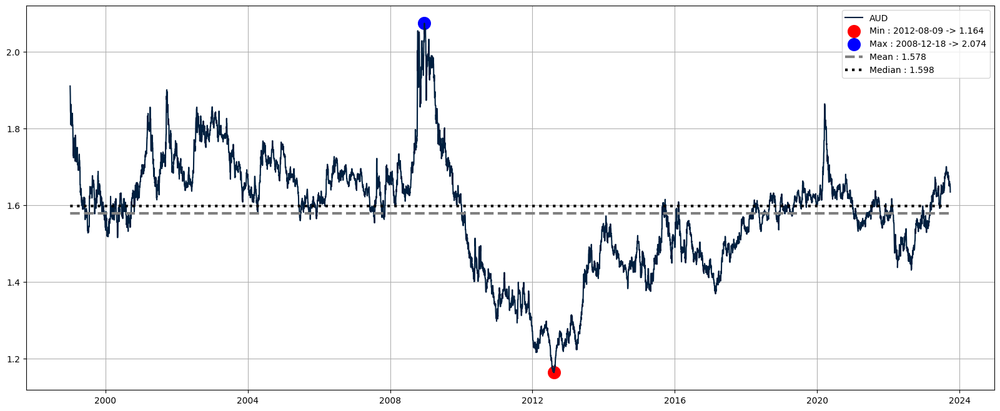

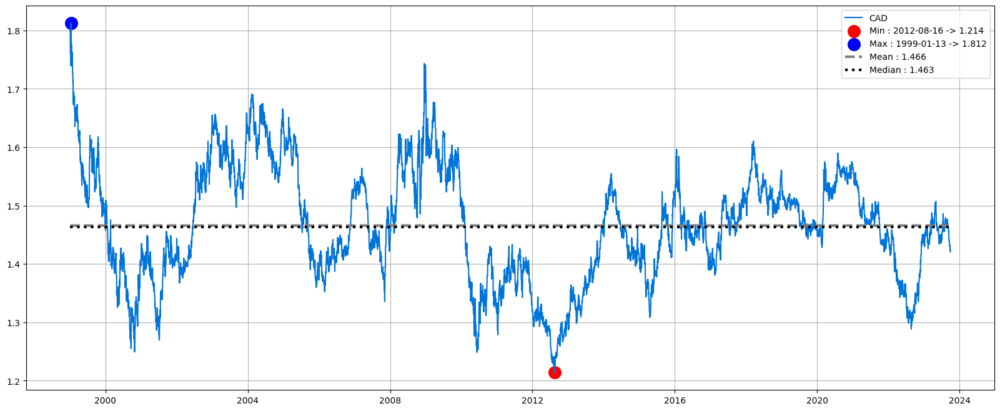

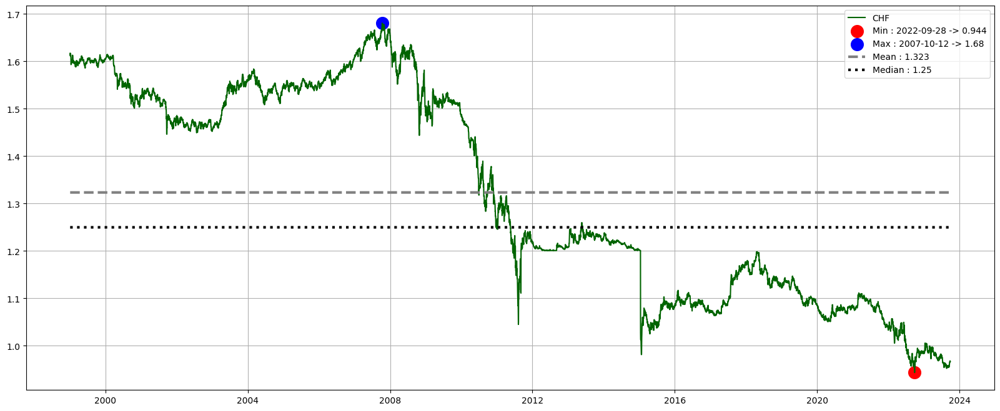

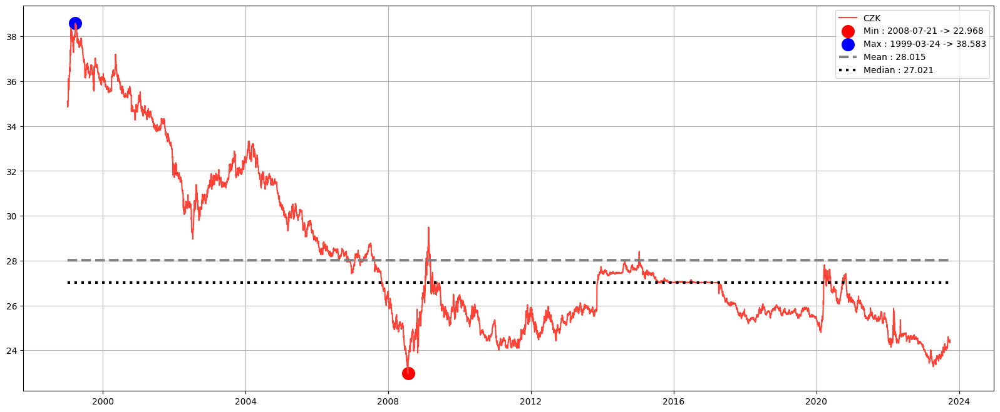

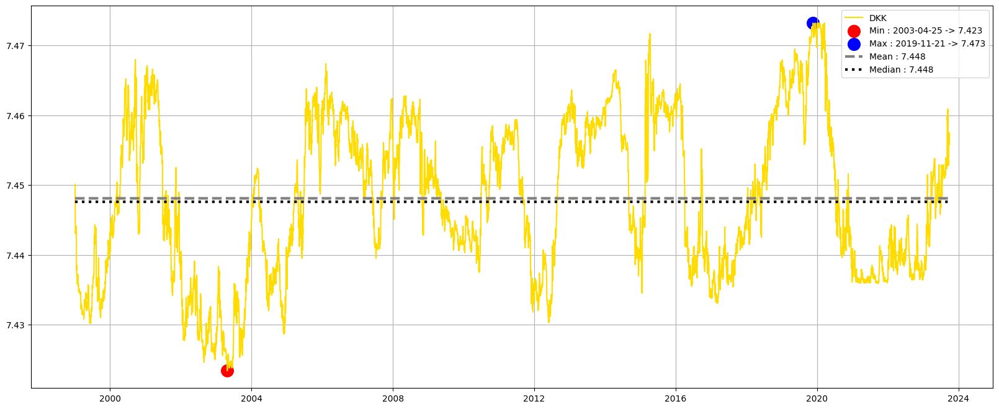

...

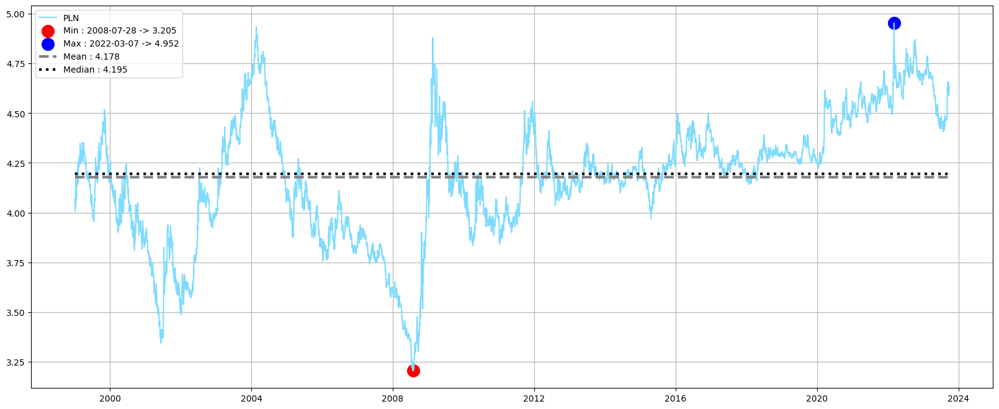

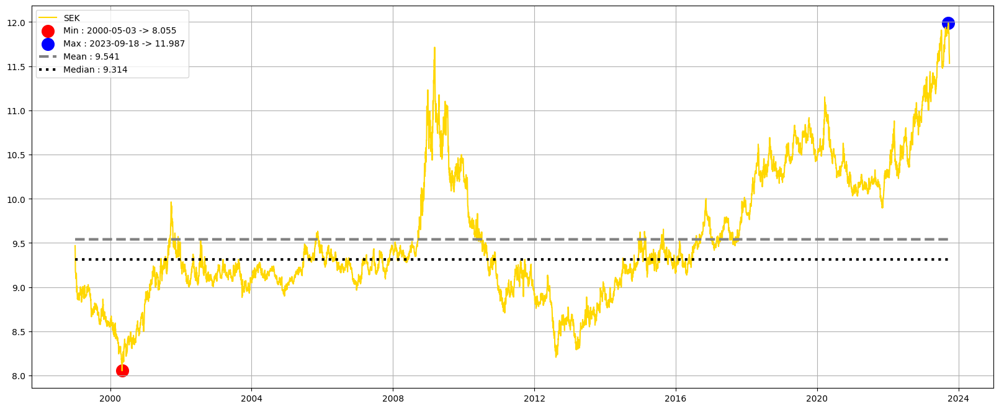

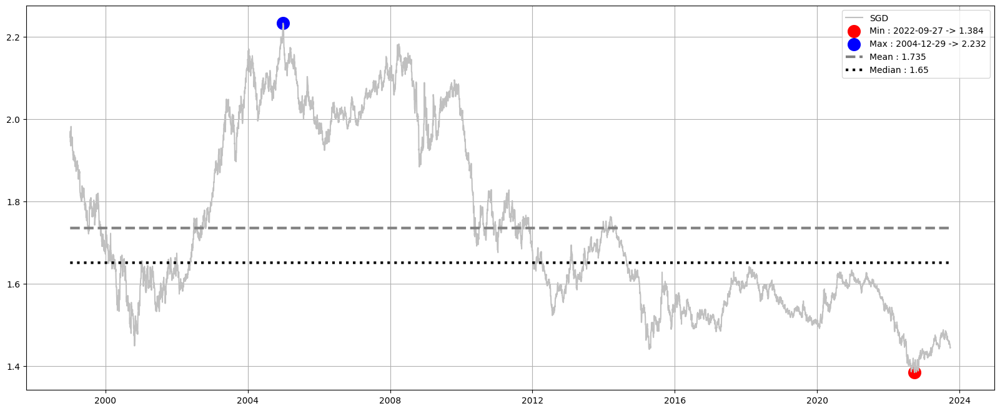

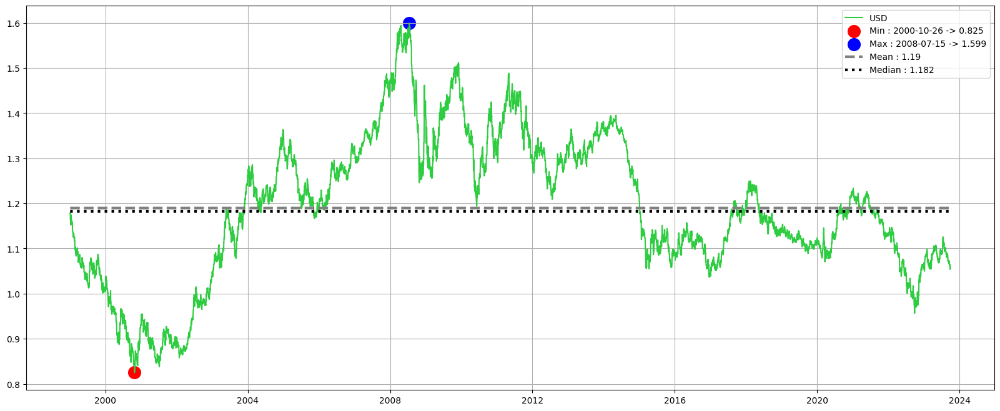

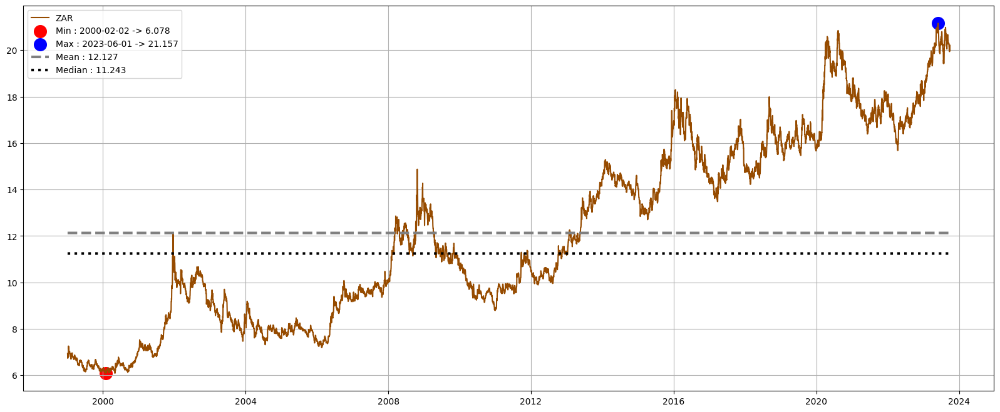

In [11]:
for coin, color in zip(historical.columns[:-2], colours.values()):
    
    plt.figure(figsize=(20, 8))
    
    plt.plot(historical["Dates"], historical[coin], color = color, label = f"{coin}")
    
    min_x = historical[historical[coin] == historical[coin].min()]["Dates"].values[0]
    min_y = historical[coin].min()
    
    max_x = historical[historical[coin] == historical[coin].max()]["Dates"].values[0]
    max_y = historical[coin].max()
    
    mean = round(historical[coin].mean(), 3)
    mean_array = [historical[coin].mean() for x in range(historical.shape[0])]
    
    median = round(historical[coin].median(), 3)
    median_array = [historical[coin].median() for x in range(historical.shape[0])]
    
    plt.scatter(min_x, min_y, color = "red", label = f"Min : {str(min_x)[:10]} -> {round(min_y, 3)}", s = 200)
    plt.scatter(max_x, max_y, color = "blue", label = f"Max : {str(max_x)[:10]} -> {round(max_y, 3)}", s = 200)
    plt.plot(historical["Dates"], mean_array, color = "grey", label = f"Mean : {mean}", linestyle = "--", linewidth = 3)
    plt.plot(historical["Dates"], median_array, color = "black", label = f"Median : {median}", linestyle = ":", linewidth = 3)
    
    plt.legend()
    plt.grid()
    
    plt.savefig(f"Data/currencies_time_line_imgs/grafico_linea_temporal_{coin}.png")
    
    plt.show()

In [12]:
fig_red_line = px.line(data_frame = historical, x = "Dates", y = historical.columns[:-2],
                  title = "Línea Temporal de las Divisas que tienen registro desde el inicio con respecto a 1€",
                  width = 1000, height = 600, template = "seaborn")

fig_red_line.update_xaxes(title_text="Fechas")
fig_red_line.update_yaxes(title_text="Equivalencia")

fig_red_line.show()

fig_red_line.write_html("Data/grafico_temporal_reducido_divisas.html")

Ordenamos la información del máximo, mínimo y la media de cada divisa de la que tenemos un registro histórico completo, desde que Frankfurter empezó a registrar. A continuación, visualizamos esta información para darle un sentido más interactivo.

In [13]:
historical_stats = historical.iloc[: , : -2].describe().loc[["max", "min", "mean"]].T.sort_values(by = "mean", ascending = False)

historical_stats

,max,min,mean
KRW,1993.95000,938.6700,1351.384996
HUF,430.65000,228.1600,291.914973
JPY,169.75000,89.3000,128.299502
CZK,38.58300,22.9680,28.015314
ZAR,21.15700,6.0785,12.127401
SEK,11.98720,8.0550,9.541260
HKD,12.47020,6.4361,9.257823
NOK,12.31650,7.2225,8.701037
DKK,7.47320,7.4234,7.448098
PLN,4.95250,3.2053,4.178175


In [16]:
cheap_currency = historical_stats.index[0]
cheap_currency_mean = round(historical_stats.iloc[0, -1], 2)

expensive_currency = historical_stats.index[-1]
expensive_currency_mean = round(historical_stats.iloc[-1, -1], 3)

pct = round(expensive_currency_mean * 100 / cheap_currency_mean, 4)
times = round(cheap_currency_mean / expensive_currency_mean, 2)

print("-"*121)
print(f"""El anterior DataFrame nos indica que '{cheap_currency}' es la divisa más económica, con una media de {cheap_currency_mean}, mientras que '{expensive_currency}' es la
divisa más costosa con una media de {expensive_currency_mean}.\n""")
print("Con estos datos a mano, podemos decir que:\n")
print(f"'{cheap_currency}' representa, de media, un {pct}% de lo que cuesta '{expensive_currency}'.\n")
print(f"'{expensive_currency}' es, de media, {times} veces más caro que '{cheap_currency}'.")
print("-"*121)

-------------------------------------------------------------------------------------------------------------------------
El anterior DataFrame nos indica que 'KRW' es la divisa más económica, con una media de 1351.38, mientras que 'GBP' es la
divisa más costosa con una media de 0.778.

Con estos datos a mano, podemos decir que:

'KRW' representa, de media, un 0.0576% de lo que cuesta 'GBP'.

'GBP' es, de media, 1736.99 veces más caro que 'KRW'.
-------------------------------------------------------------------------------------------------------------------------


In [17]:
fig_red_scat = px.scatter(data_frame = historical_stats, x = "mean", y = historical_stats.index,
                     size = "max", size_max = 150, color = "mean", range_color = [0, times],
                     title = "Media de las Divisas que tienen registro desde el inicio con respecto a 1€",
                     width = 1000, height = 600, template = "seaborn")

fig_red_scat.update_xaxes(title_text="Media")
fig_red_scat.update_yaxes(title_text="Divisas")

fig_red_scat.show()

fig_red_scat.write_html("Data/grafico_estadistico_reducido_divisas.html")

Guardamos el DataFrame "reducido" para usarlo más adelante y no tener que ejecutar todo el Notebook.

In [ ]:
historical.to_parquet("Data/historical_reduced.parquet")
historical_stats.to_parquet("Data/historical_stats_reduced.parquet")

In [ ]:
del historical
del historical_stats

## Model - Deep Learning

Procedemos a preparar la data para entrenar el modelo de prueba. Primero, vamos a entender cómo se realizará el proceso probando con el dólar estadounidense. Luego, ejecutaremos la función que realizará el entrenamiento de los modelos.

In [18]:
from math import sqrt

from statsmodels.tsa.seasonal import seasonal_decompose

from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

from keras.preprocessing.sequence import TimeseriesGenerator
from keras.layers import Input, Dense, Flatten, Embedding, LSTM
from keras.models import Sequential
from keras.optimizers import Adam

In [ ]:
# Hacer una función para crear un nuevo dataframe a partir de "historical" que contenga la divisa que queremos predecir y las fechas
# Que la misma función luego entrene un nuevo modelo con esos datos y guarde el modelo en la carpeta "Data/models"

def ts_forecasting(df):
    
    pass



In [19]:
historical = pd.read_parquet("Data/historical_reduced.parquet")

In [20]:
historical

,AUD,CAD,CHF,CZK,DKK,GBP,HKD,HUF,JPY,KRW,NOK,NZD,PLN,SEK,SGD,USD,ZAR,EUR,Dates
0,1.9100,1.8004,1.6168,35.107,7.4501,0.71110,9.1332,251.48,133.73,1398.59,8.8550,2.2229,4.0712,9.4696,1.9554,1.1789,6.9358,1,1999-01-04
1,1.8944,1.7965,1.6123,34.917,7.4495,0.71220,9.1341,250.80,130.96,1373.01,8.7745,2.2011,4.0245,9.4025,1.9655,1.1790,6.7975,1,1999-01-05
2,1.8820,1.7711,1.6116,34.850,7.4452,0.70760,9.1010,250.67,131.42,1359.54,8.7335,2.1890,4.0065,9.3050,1.9699,1.1743,6.7307,1,1999-01-06
3,1.8474,1.7602,1.6165,34.886,7.4431,0.70585,9.0131,250.09,129.43,1337.16,8.6295,2.1531,4.0165,9.1800,1.9436,1.1632,6.8283,1,1999-01-07
4,1.8406,1.7643,1.6138,34.938,7.4433,0.70940,9.0302,250.15,130.09,1366.73,8.5900,2.1557,4.0363,9.1650,1.9537,1.1659,6.7855,1,1999-01-08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9030,1.6544,1.4311,0.9676,24.377,7.4571,0.86965,8.3126,391.08,158.08,1422.96,11.4300,1.7823,4.5893,11.7280,1.4524,1.0633,19.9410,1,2023-09-25
9031,1.6539,1.4318,0.9675,24.411,7.4575,0.87020,8.2942,388.88,157.87,1430.12,11.4400,1.7782,4.6093,11.6540,1.4500,1.0605,20.1390,1,2023-09-26
9032,1.6541,1.4255,0.9680,24.470,7.4566,0.86810,8.2397,390.85,157.20,1425.19,11.3610,1.7779,4.6250,11.6255,1.4449,1.0536,20.2220,1,2023-09-27
9033,1.6483,1.4206,0.9678,24.378,7.4558,0.86333,8.2491,392.35,157.33,1426.71,11.3160,1.7698,4.6343,11.6065,1.4431,1.0539,20.1700,1,2023-09-28


Ejemplo utilizando el dólar estadounidense para representar lo que se realizará.

In [21]:
forecasting = historical[["Dates", "USD"]]

forecasting.set_index("Dates", inplace = True)

forecasting

,USD
Dates,
1999-01-04,1.1789
1999-01-05,1.1790
1999-01-06,1.1743
1999-01-07,1.1632
1999-01-08,1.1659
...,...
2023-09-25,1.0633
2023-09-26,1.0605
2023-09-27,1.0536


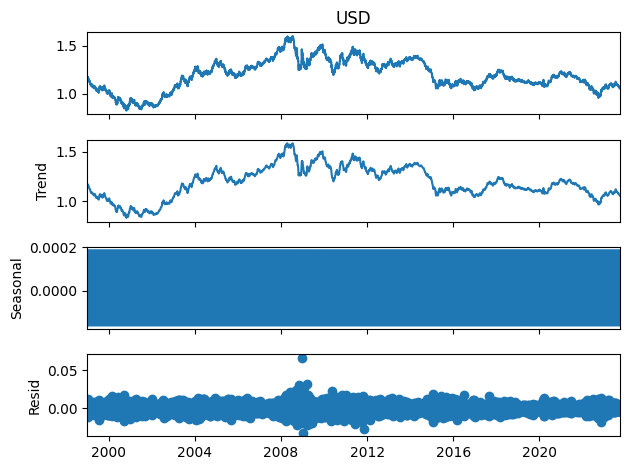

In [22]:
seasonal_decompose(forecasting["USD"]).plot(); # Si no se añade el punto y coma al final entonces realiza el plot dos veces

Separamos en "train" y "test" para predecir los últimos 30 días.

In [41]:
days_to_forecast = 30
cut = len(forecasting) - days_to_forecast

train = forecasting.iloc[:cut]
test = forecasting.iloc[cut:]

train, test

(               USD
 Dates             
 1999-01-04  1.1789
 1999-01-05  1.1790
 1999-01-06  1.1743
 1999-01-07  1.1632
 1999-01-08  1.1659
 ...            ...
 2023-08-26  1.0808
 2023-08-27  1.0808
 2023-08-28  1.0808
 2023-08-29  1.0803
 2023-08-30  1.0886
 
 [9005 rows x 1 columns],
                USD
 Dates             
 2023-08-31  1.0868
 2023-09-01  1.0844
 2023-09-02  1.0844
 2023-09-03  1.0844
 2023-09-04  1.0801
 2023-09-05  1.0731
 2023-09-06  1.0745
 2023-09-07  1.0710
 2023-09-08  1.0704
 2023-09-09  1.0704
 2023-09-10  1.0704
 2023-09-11  1.0724
 2023-09-12  1.0713
 2023-09-13  1.0733
 2023-09-14  1.0730
 2023-09-15  1.0658
 2023-09-16  1.0658
 2023-09-17  1.0658
 2023-09-18  1.0663
 2023-09-19  1.0713
 2023-09-20  1.0702
 2023-09-21  1.0635
 2023-09-22  1.0647
 2023-09-23  1.0647
 2023-09-24  1.0647
 2023-09-25  1.0633
 2023-09-26  1.0605
 2023-09-27  1.0536
 2023-09-28  1.0539
 2023-09-29  1.0594)

Escalamos los datos.

In [42]:
scaler = MinMaxScaler()

scaled_train = scaler.fit_transform(train)
scaled_test = scaler.transform(test)

scaled_train[:10], scaled_test[:10]

(array([[0.45709486],
        [0.45722409],
        [0.45115017],
        [0.43680538],
        [0.44029465],
        [0.44029465],
        [0.44029465],
        [0.42866374],
        [0.42233135],
        [0.4512794 ]]),
 array([[0.33807185],
        [0.33497028],
        [0.33497028],
        [0.33497028],
        [0.32941329],
        [0.32036702],
        [0.32217627],
        [0.31765314],
        [0.31687775],
        [0.31687775]]))

In [43]:
n_input = days_to_forecast
n_features = 1

generator = TimeseriesGenerator(scaled_train, scaled_train, length = n_input, batch_size = 1) # Utilizamos un "length" de 30 días

In [44]:
X, y = generator[0]

print(f"Array: \n{X.flatten()}")
print(f"Prediction: \n{y}")

Array: 
[0.45709486 0.45722409 0.45115017 0.43680538 0.44029465 0.44029465
 0.44029465 0.42866374 0.42233135 0.4512794  0.43951926 0.43602998
 0.43602998 0.43602998 0.43422073 0.43473766 0.42943913 0.42905143
 0.42840527 0.42840527 0.42840527 0.43060222 0.43034376 0.42349444
 0.40811579 0.40475575 0.40475575 0.40475575 0.39881106 0.39868183]
Prediction: 
[[0.39868183]]


Usaremos el Sequential de keras con una capa Long Short-Term Memory (LSTM) de entrada.

In [45]:
model = Sequential()

# model.add(Input(shape = (data_train.shape[1], )))

model.add(LSTM(256, activation = "relu", input_shape = (n_input, n_features)))
model.add(Dense(units = 128, activation="relu"))
# model.add(Dense(units = 30, activation="relu"))
# model.add(Dense(units = 15, activation="relu")) 

model.add(Dense(1))

model.compile(optimizer = "adam", loss = "mse")

In [46]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_1 (LSTM)               (None, 256)               264192    
                                                                 
 dense_1 (Dense)             (None, 128)               32896     
                                                                 
 dense_2 (Dense)             (None, 1)                 129       
                                                                 
Total params: 297217 (1.13 MB)
Trainable params: 297217 (1.13 MB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [47]:
model.fit(generator, epochs = 10)

Epoch 1/10
8975/8975 [==============================] - 65s 7ms/step - loss: 6.0000e-04
Epoch 2/10
8975/8975 [==============================] - 66s 7ms/step - loss: 1.8678e-04
Epoch 3/10
8975/8975 [==============================] - 63s 7ms/step - loss: 1.4853e-04
Epoch 4/10
8975/8975 [==============================] - 67s 8ms/step - loss: 1.4243e-04
Epoch 5/10
8975/8975 [==============================] - 67s 7ms/step - loss: 1.2604e-04
Epoch 6/10
8975/8975 [==============================] - 62s 7ms/step - loss: 1.1948e-04
Epoch 7/10
8975/8975 [==============================] - 63s 7ms/step - loss: 1.2239e-04
Epoch 8/10
8975/8975 [==============================] - 62s 7ms/step - loss: 1.1546e-04
Epoch 9/10
8975/8975 [==============================] - 64s 7ms/step - loss: 1.1166e-04
Epoch 10/10
8975/8975 [==============================] - 64s 7ms/step - loss: 1.0952e-04


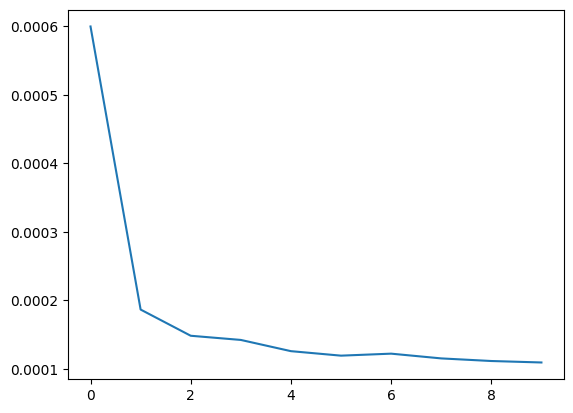

In [48]:
loss_per_epoch = model.history.history["loss"]

plt.plot(range(len(loss_per_epoch)), loss_per_epoch)

In [49]:
last_train_batch = scaled_train[-days_to_forecast:] # 30 días

last_train_batch = last_train_batch.reshape((1, n_input, n_features))

model.predict(last_train_batch)

1/1 [==============================] - 0s 164ms/step


array([[0.33942872]], dtype=float32)

In [50]:
scaled_test[0]

array([0.33807185])

In [51]:
test_predictions = list()

first_eval_batch = scaled_train[-n_input:]
current_batch = first_eval_batch.reshape((1, n_input, n_features))

for i in range(len(test)):
    
    # Get the prediction value for the first batch
    current_pred = model.predict(current_batch)[0]
    
    # Append the prediction into the array
    test_predictions.append(current_pred)
    
    # Use the prediction to update the batch and remove the first value
    current_batch = np.append(current_batch[:,1:,:], [[current_pred]], axis = 1)

1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 15ms/step


In [52]:
test_predictions

[array([0.33942872], dtype=float32),
 array([0.33956644], dtype=float32),
 array([0.33969143], dtype=float32),
 array([0.33978918], dtype=float32),
 array([0.3398786], dtype=float32),
 array([0.3399687], dtype=float32),
 array([0.34006304], dtype=float32),
 array([0.3401623], dtype=float32),
 array([0.3402663], dtype=float32),
 array([0.3403743], dtype=float32),
 array([0.3404856], dtype=float32),
 array([0.3405996], dtype=float32),
 array([0.34071577], dtype=float32),
 array([0.34083372], dtype=float32),
 array([0.3409532], dtype=float32),
 array([0.34107405], dtype=float32),
 array([0.34119606], dtype=float32),
 array([0.3413192], dtype=float32),
 array([0.34144336], dtype=float32),
 array([0.34156853], dtype=float32),
 array([0.34169468], dtype=float32),
 array([0.3418218], dtype=float32),
 array([0.34194982], dtype=float32),
 array([0.3420788], dtype=float32),
 array([0.34220874], dtype=float32),
 array([0.34233963], dtype=float32),
 array([0.34247148], dtype=float32),
 array([0.34

<Axes: xlabel='Dates'>

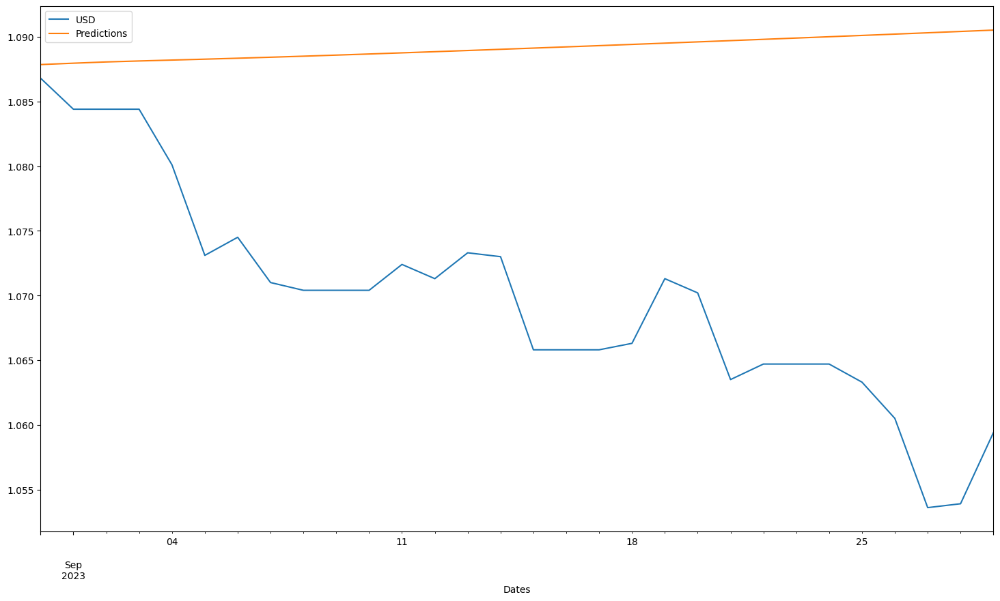

In [53]:
true_predictions = scaler.inverse_transform(test_predictions)

test["Predictions"] = true_predictions

test.plot(figsize = (18, 10))

In [54]:
rmse = sqrt(mean_squared_error(test["USD"], test["Predictions"]))

print(f"mean_squared_error : {rmse}")

mean_squared_error : 0.021313929610812743


In [55]:
with open('Data/models/modelo_usd.pkl', 'wb') as file:
    pickle.dump(model, file)
    
with open('Data/models/scaler_usd.pkl', 'wb') as file:
    pickle.dump(scaler, file)

Procedemos a entrenar un modelo para cada divisa. Guardaremos tanto los escaladores como los modelos.

In [ ]:
# for currency in historical.columns[:-2]:
    
#     historical_to_forecasting = historical[["Date", currency]]
        
#     currency_test = ts_forecasting(historical_to_forecasting)

In [3]:
url = "https://api.frankfurter.app"

endpoint = f"{url}/currencies"

respond = requests.get(endpoint).json()

respond

{'AUD': 'Australian Dollar',
 'BGN': 'Bulgarian Lev',
 'BRL': 'Brazilian Real',
 'CAD': 'Canadian Dollar',
 'CHF': 'Swiss Franc',
 'CNY': 'Chinese Renminbi Yuan',
 'CZK': 'Czech Koruna',
 'DKK': 'Danish Krone',
 'EUR': 'Euro',
 'GBP': 'British Pound',
 'HKD': 'Hong Kong Dollar',
 'HUF': 'Hungarian Forint',
 'IDR': 'Indonesian Rupiah',
 'ILS': 'Israeli New Sheqel',
 'INR': 'Indian Rupee',
 'ISK': 'Icelandic Króna',
 'JPY': 'Japanese Yen',
 'KRW': 'South Korean Won',
 'MXN': 'Mexican Peso',
 'MYR': 'Malaysian Ringgit',
 'NOK': 'Norwegian Krone',
 'NZD': 'New Zealand Dollar',
 'PHP': 'Philippine Peso',
 'PLN': 'Polish Złoty',
 'RON': 'Romanian Leu',
 'SEK': 'Swedish Krona',
 'SGD': 'Singapore Dollar',
 'THB': 'Thai Baht',
 'TRY': 'Turkish Lira',
 'USD': 'United States Dollar',
 'ZAR': 'South African Rand'}

In [4]:
import json

with open('Data/current_currencies.json', 'w') as file:
    json.dump(respond, file)

In [ ]:
################################################## XXXXXXXXXXXXXXXXXXXX ###################################################